In [1]:
import numpy as np
import pandas as pג
import cv2
import glob
from torch.utils.data import Dataset,DataLoader
from torchvision import datasets, models, transforms
#from torchvision.ops import focal_loss
import torch
from torch.optim.lr_scheduler import ReduceLROnPlateau
from matplotlib import pyplot as plt
import os
from cv2 import imread
from sklearn.model_selection import train_test_split
#from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay, accuracy_score
from sklearn.utils.class_weight import compute_class_weight
import torch.nn as nn
from torch.nn import functional as F
from torch.autograd import Variable
import random
!pip install albumentations==0.4.6
import albumentations as A
!pip install torchmetrics
import torchmetrics as metric
!pip install tqdm
from tqdm import tqdm

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [2]:
from google.colab import drive 
drive.mount('/content/drive', force_remount=True)
data_path = os.path.join('/content/drive',"MyDrive","Afeka_FaceData2022")

Mounted at /content/drive


In [3]:
labels_as_num = []
def split_paths_train_val(data_path, train_size):
  images_paths = [glob.glob(os.path.join(data_path, d, "*.*")) for d in os.listdir(data_path)]

  x_train, y_train, x_test, y_test = [], [], [], []
  for dir in images_paths:
    x_train_person, x_test_person = np.split(dir, [int(len(dir)*train_size)])

    label = dir[0].split('/')[-2]
    labels_as_num.append(label)
    y_train_person = [label]*len(x_train_person)
    y_test_person = [label]*len(x_test_person)

    x_train = [*x_train, *x_train_person]
    x_test = [*x_test, *x_test_person]
    y_train = [*y_train, *y_train_person]
    y_test = [*y_test, *y_test_person]

  return len(images_paths), x_train, y_train, x_test, y_test

In [71]:

transform = A.Compose([
  A.HorizontalFlip(p=0.5),
  A.GaussNoise(p=0.7, var_limit=(30, 80)),
  #A.GaussianBlur(p=0.7, blur_limit=(5,11)),
  A.RandomContrast(p=0.7),
  A.RandomBrightness(p=0.7),
])

class load_data(Dataset):
  def __init__(self, x, y, person_size, transform=None):
    self.images = x
    self.labels = y
    self.transform = transform
    self.person_size = person_size

    self.size = len(self.images)

  def __len__(self):
    return self.size

  def __getitem__(self, idx):
    img = self.images[idx]
    label = self.labels[idx]

    img = cv2.imread(img)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img = cv2.resize(img, (224, 224))

    if self.transform:
      img = self.transform(image=img)
      img = img['image']

    img = img.transpose((2, 0, 1))

    return img, label

In [5]:
person_size, x_train, y_train, x_test, y_test = split_paths_train_val(data_path, 0.8)

In [6]:
train_Dataset = load_data(x_train, y_train, person_size, transform)
test_Dataset = load_data(x_test, y_test, person_size)

In [7]:
train_loader = DataLoader(dataset=train_Dataset, batch_size=20, shuffle=True)
test_loader = DataLoader(dataset=test_Dataset, batch_size=20)

In [8]:
def display_all_images(loader, data_size, row_size):
  plt.figure(figsize=(30, (data_size/row_size + 1)*3))
  for i, (imgs, labels) in enumerate(loader):
    for j, (img, label) in enumerate(zip(imgs, labels), start=1):
      plt.subplot(data_size/row_size + 1, row_size, 20*i + j)
      plt.title(label)
      img = img.transpose(0,2)
      img = img.swapaxes(0,1)
      plt.imshow(img)
      plt.axis('off')

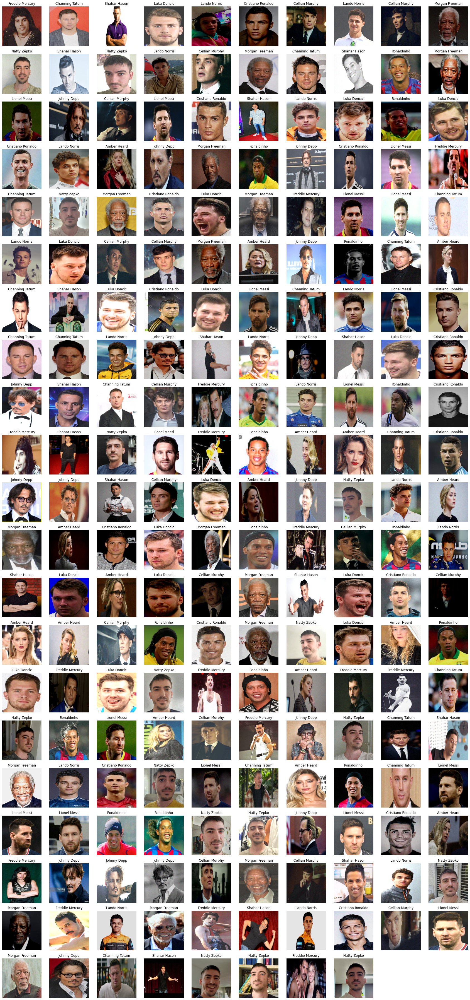

In [9]:
display_all_images(train_loader, len(train_loader.dataset), 10)

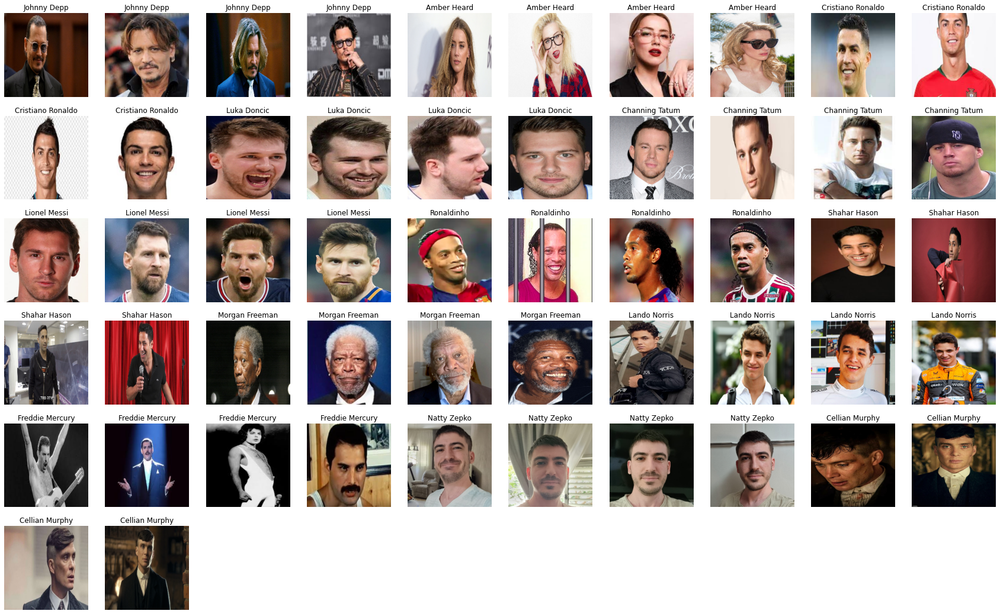

In [10]:
display_all_images(test_loader, len(test_loader.dataset), 10)

#VGG16

One of the best SOTA CNN architectures to detect features in image. Consider to be upgrade of popular alexNet. Uses repeated 3X3 convolution filters to detect features and maxpooling for downsampalling the image by half after each convolution block. Won image net at 2014.

In [11]:
class VGG16(nn.Module):
  def __init__(self, num_of_classes):
        super(VGG16, self).__init__()
        self.relu = nn.ReLU()

        self.conv1_1 = nn.Conv2d(in_channels=3, out_channels=64, kernel_size=3, padding=1)
        self.conv1_2 = nn.Conv2d(in_channels=64, out_channels=64, kernel_size=3, padding=1)

        self.conv2_1 = nn.Conv2d(in_channels=64, out_channels=128, kernel_size=3, padding=1)
        self.conv2_2 = nn.Conv2d(in_channels=128, out_channels=128, kernel_size=3, padding=1)

        self.conv3_1 = nn.Conv2d(in_channels=128, out_channels=256, kernel_size=3, padding=1)
        self.conv3_2 = nn.Conv2d(in_channels=256, out_channels=256, kernel_size=3, padding=1)
        self.conv3_3 = nn.Conv2d(in_channels=256, out_channels=256, kernel_size=3, padding=1)

        self.conv4_1 = nn.Conv2d(in_channels=256, out_channels=512, kernel_size=3, padding=1)
        self.conv4_2 = nn.Conv2d(in_channels=512, out_channels=512, kernel_size=3, padding=1)
        self.conv4_3 = nn.Conv2d(in_channels=512, out_channels=512, kernel_size=3, padding=1)

        self.conv5_1 = nn.Conv2d(in_channels=512, out_channels=512, kernel_size=3, padding=1)
        self.conv5_2 = nn.Conv2d(in_channels=512, out_channels=512, kernel_size=3, padding=1)
        self.conv5_3 = nn.Conv2d(in_channels=512, out_channels=512, kernel_size=3, padding=1)

        self.maxpool = nn.MaxPool2d(kernel_size=2, stride=2)

        self.fc1 = nn.Linear(25088, 4096)
        self.fc2 = nn.Linear(4096, 4096)
        self.fc3 = nn.Linear(4096, num_of_classes)

  def forward(self, x):
        x = self.relu(self.conv1_1(x))
        x = self.relu(self.conv1_2(x))
        x = self.maxpool(x)

        x = self.relu(self.conv2_1(x))
        x = self.relu(self.conv2_2(x))
        x = self.maxpool(x)

        x = self.relu(self.conv3_1(x))
        x = self.relu(self.conv3_2(x))
        x = self.relu(self.conv3_3(x))
        x = self.maxpool(x)

        x = self.relu(self.conv4_1(x))
        x = self.relu(self.conv4_2(x))
        x = self.relu(self.conv4_3(x))
        x = self.maxpool(x)

        x = self.relu(self.conv5_1(x))
        x = self.relu(self.conv5_2(x))
        x = self.relu(self.conv5_3(x))
        x = self.maxpool(x)

        x = x.reshape(x.shape[0], -1)
        x = self.relu(self.fc1(x))
        x = F.dropout(x, 0.5) #dropout was included to combat overfitting
        x = self.relu(self.fc2(x))
        x = F.dropout(x, 0.5)
        x = self.fc3(x)
        return x

In [12]:
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
print(device)

cuda


#Helping Class for train test and kpis and loss

In [13]:
class kpis_loss_cls():
  def __init__(self):
    self.acc = metric.Accuracy(threshold=0.5, num_classes=len(labels_as_num)) # accuracy
    self.acc.to(device)
    self.pres = metric.Precision(num_classes=len(labels_as_num),threshold=0.5) # precition
    self.pres.to(device)
    self.recal = metric.Recall(num_classes=len(labels_as_num),threshold=0.5) # recall
    self.recal.to(device)

    self.acc_plot =[[],[]]
    self.pres_plot = [[],[]]
    self.recall_plot =[[],[]]
    self.loss_plot =[[],[]]

    self.acc_epoch =[[],[]]
    self.pres_epoch = [[],[]]
    self.recall_epoch =[[],[]]
    self.loss_epoch =[[],[]]

  def update_kpis_loss_epoch(self):
    self.acc_plot[0].append(np.mean(self.acc_epoch[0]))
    self.acc_plot[1].append(np.mean(self.acc_epoch[1]))

    self.pres_plot[0].append(np.mean(self.pres_epoch[0]))
    self.pres_plot[1].append(np.mean(self.pres_epoch[1]))

    self.recall_plot[0].append(np.mean(self.recall_epoch[0]))
    self.recall_plot[1].append(np.mean(self.recall_epoch[1]))

    self.loss_plot[0].append(np.mean(self.loss_epoch[0]))
    self.loss_plot[1].append(np.mean(self.loss_epoch[1]))

    self.acc_epoch =[[],[]]
    self.pres_epoch = [[],[]]
    self.recall_epoch =[[],[]]
    self.loss_epoch =[[],[]]

  def reset_kpis_state(self):
    self.acc.reset()
    self.pres.reset()
    self.recal.reset()

  def append_kpis_loss(self, loss, predict, target, isTrain=True):
    if isTrain:
      self.acc_epoch[0].append(self.acc(predict, target).detach().cpu())
      self.pres_epoch[0].append(self.pres(predict, target).detach().cpu())
      self.recall_epoch[0].append(self.recal(predict, target).detach().cpu())
      self.loss_epoch[0].append(loss)
    else:
      self.acc_epoch[1].append(self.acc(predict, target).detach().cpu())
      self.pres_epoch[1].append(self.pres(predict, target).detach().cpu())
      self.recall_epoch[1].append(self.recal(predict, target).detach().cpu())
      self.loss_epoch[1].append(loss)
    
    # Reseting internal state such that metric ready for new data
    self.reset_kpis_state()
    
  def display_kpis_loss_epoch(self, epoch):
    print(f"\nEpoch #{epoch}: Train Loss = {np.mean(self.loss_epoch[0])} Validation Loss = {np.mean(self.loss_epoch[1])}")
    print(f"Epoch #{epoch}: Accuracy = {np.mean(self.acc_epoch[0])} Validation Accuracy = {np.mean(self.acc_epoch[1])}")
    print(f"Epoch #{epoch}: Recall = {np.mean(self.recall_epoch[0])} Validation Recall = {np.mean(self.recall_epoch[1])}")
    print(f"Epoch #{epoch}: Precision = {np.mean(self.pres_epoch[0])} Validation Precision = {np.mean(self.pres_epoch[1])}")

  def plot_metric(self, param, run_type):
    plt.figure(figsize=(10,10))
    plt.grid()
    plt.plot(range(1, epochs+1), param[0], 'g', label=f"Training {run_type}")
    plt.plot(range(1, epochs+1), param[1], 'b', label=f"validation {run_type}")
    plt.title(f"Training and Validation {run_type}")
    plt.xlabel('Epochs')
    plt.ylabel(run_type)
    plt.legend()
    plt.show()

  def plot_kpis_loss(self):
    self.plot_metric(self.loss_plot, "Loss")
    self.plot_metric(self.acc_plot, "Accuracy")
    self.plot_metric(self.recall_plot, "Recall")
    self.plot_metric(self.pres_plot, "Precision")

In [14]:
def getnumericalLabels(label):
  batch_label = []
  for l in label:
    batch_label.append(labels_as_num.index(l))

  return torch.tensor(batch_label)  

#Optimizer and hyper parameters.

Hyper parameters been set to initial default values.

Learning rate been set to 0.00001 after some experimentation.

Loss function is Cross Entropy which is best suited for balanced classification task.

As rule of thumb in training initialization, the optimizer is ADAM for lack of reasons to use any other optimizer.

Number of epochs been determined by the task which is 30

Batch size been choose early in dataloader segment to 20 considering the size of dataset which is relatively small. In addition, VGG16 have around 138 million parameters, we simply cant run it with large batch size.

In [15]:
vgg16 = VGG16(len(labels_as_num)).to(device)
ce_loss = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(vgg16.parameters(), lr = 0.00001)
epochs = 30

#Train/Test

In [16]:
from scipy.special import softmax

In [17]:
def test(model,df, kpis_loss):
  with torch.no_grad():
    for i, data in enumerate(df, 0):
        x_test, y_test = data
        # x_test = np.swapaxes(x_test,1,3)
        x_test = x_test.float()
        y_test = getnumericalLabels(y_test)

        out = model(x_test.to(device))
        loss = ce_loss(out,y_test.to(device))
        a, predicted = torch.max(out, 1)
        
        kpis_loss.append_kpis_loss(loss.item(), predicted.cpu(), y_test.cpu(), isTrain=False)

In [18]:
def train(model,train_data, test_data):
  kpis_loss = kpis_loss_cls()
  for e in range(epochs):
      model_loss = []
      
      for i, data in enumerate(train_data,0):
          x, y = data
          x = x.float()
          y = getnumericalLabels(y)
          
          outputs = model(x.to(device))
          loss = ce_loss(outputs, y.to(device))

          a, predicted = torch.max(outputs, 1)
          kpis_loss.append_kpis_loss(loss.item(), predicted.cpu(), y)

          loss.backward() # calculate grads
          optimizer.step() # update weights
          optimizer.zero_grad() # clear cashe of grads

          if i%5 == 0:
            print('epoch #%d batch #%d loss = %.3f accuracy = %.2f' %(e, i, loss.item(), kpis_loss.acc_epoch[0][-1]))

      torch.cuda.empty_cache()
      test(model,test_data, kpis_loss)
      kpis_loss.display_kpis_loss_epoch(e)
      kpis_loss.update_kpis_loss_epoch()
      print("\n")
  
  kpis_loss.plot_kpis_loss()

epoch #0 batch #0 loss = 2.564 accuracy = 0.05
epoch #0 batch #5 loss = 2.566 accuracy = 0.05
epoch #0 batch #10 loss = 2.572 accuracy = 0.12

Epoch #0: Train Loss = 2.5656485774300317 Validation Loss = 2.563496748606364
Epoch #0: Accuracy = 0.08409091830253601 Validation Accuracy = 0.13333334028720856
Epoch #0: Recall = 0.08409091830253601 Validation Recall = 0.13333334028720856
Epoch #0: Precision = 0.08409091830253601 Validation Precision = 0.13333334028720856


epoch #1 batch #0 loss = 2.565 accuracy = 0.20
epoch #1 batch #5 loss = 2.563 accuracy = 0.05
epoch #1 batch #10 loss = 2.565 accuracy = 0.12

Epoch #1: Train Loss = 2.565084218978882 Validation Loss = 2.5636367797851562
Epoch #1: Accuracy = 0.09318182617425919 Validation Accuracy = 0.07222222536802292
Epoch #1: Recall = 0.09318182617425919 Validation Recall = 0.07222222536802292
Epoch #1: Precision = 0.09318182617425919 Validation Precision = 0.07222222536802292


epoch #2 batch #0 loss = 2.565 accuracy = 0.05
epoch #2 batc

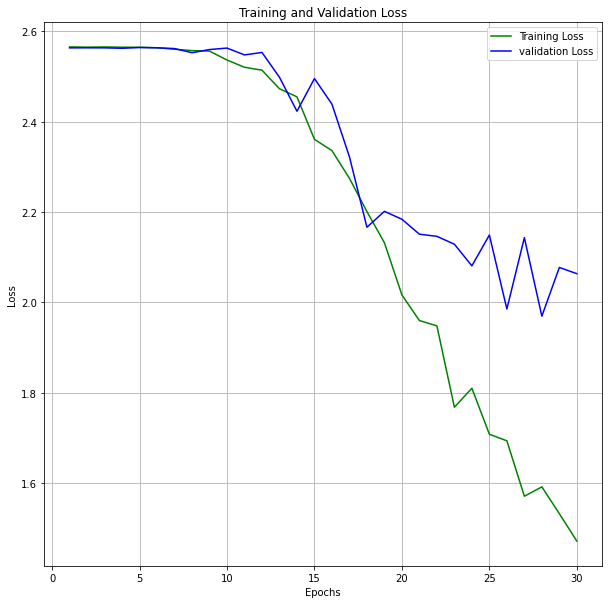

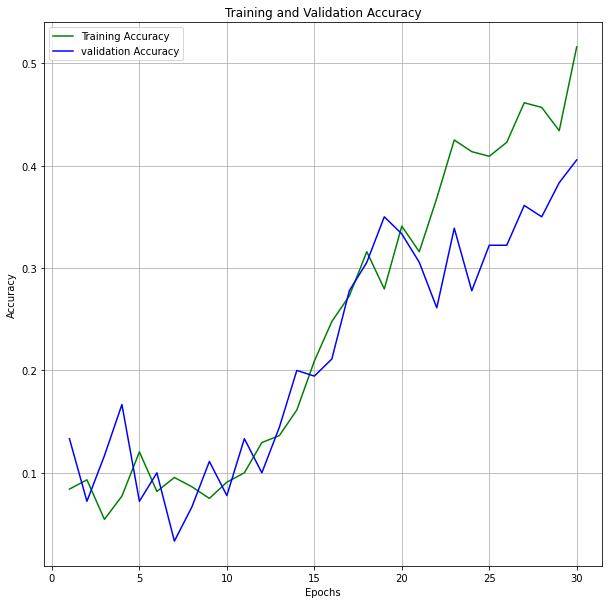

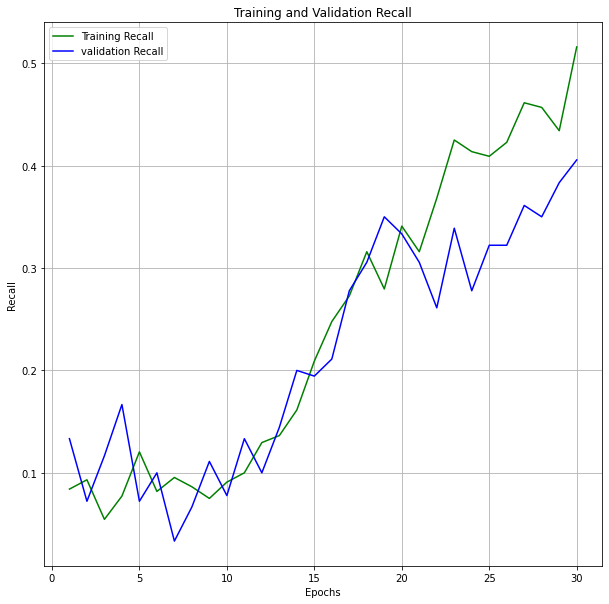

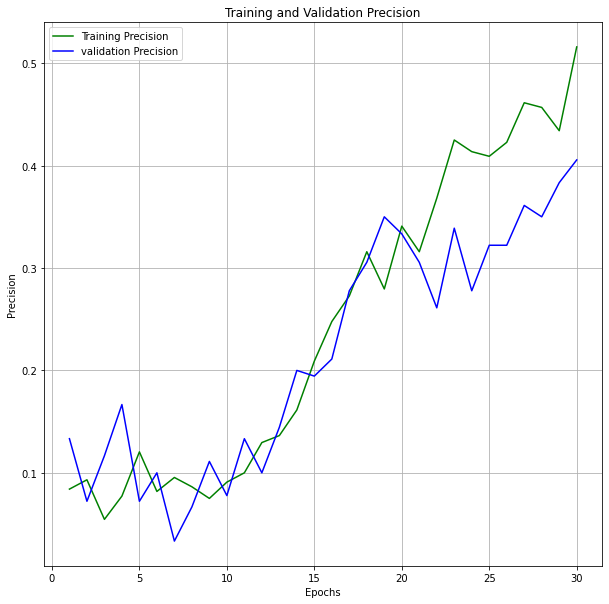

In [19]:
train(vgg16,train_loader,test_loader)

We have tried to add drop out to net architecture, remove augmentations, used diffrent optimiers with diffrent hyper parameters and none worked.

Conclution: With such small data set its impossiable to train VGG16.

In [65]:
def display_predicted_images(model):
  
  display_batch = iter(test_loader)
  img, label = next(display_batch)
  img_pred = img.float()
  out = model(img_pred.to(device))
  soft_out = F.softmax(out, -1)
  plt.figure(figsize=(30,20))
  img = np.swapaxes(img,3,1)
  img = np.swapaxes(img,1,2)

  for i in range(20):
    plt.subplot(2,10,i+1)
    index = soft_out[i].argmax()
    predicted = str(labels_as_num[index])
    plt.title("Predicted " +predicted + " \n Actuall "+ str(label[i]))
    plt.imshow(img[i])



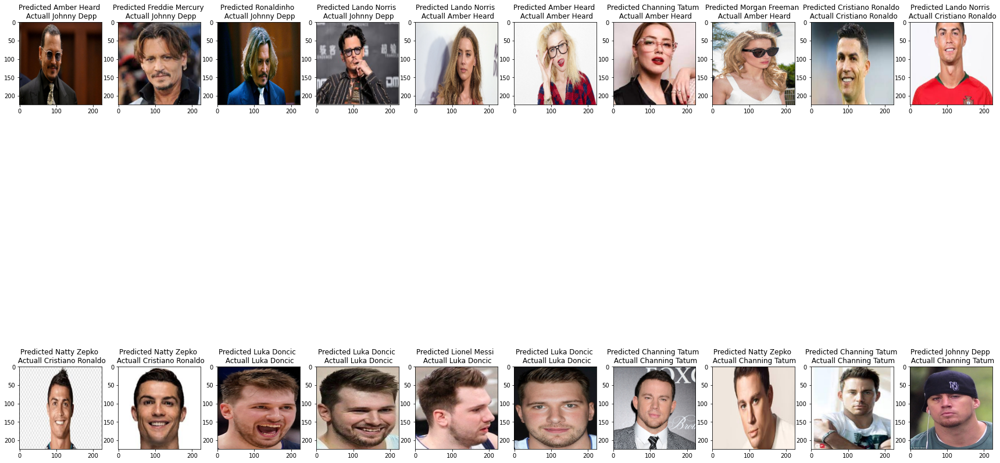

In [60]:
display_predicted_images(vgg16)

#Transfer Learning for pre trained architectures.

##VGG16 (pre trained this time to see the diffrence)

In [23]:
model_pretrain_vgg16 = models.vgg16(pretrained=True)
model_pretrain_vgg16.classifier[6] = nn.Linear(in_features=4096,out_features=len(labels_as_num),bias= True)
optimizer = torch.optim.Adam(model_pretrain_vgg16.parameters(), lr = 0.00001, weight_decay=0.1)
model_pretrain_vgg16.to(device)
epochs = 30
for param in model_pretrain_vgg16.features.parameters():
    param.requires_grad = False

Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/hub/checkpoints/vgg16-397923af.pth


  0%|          | 0.00/528M [00:00<?, ?B/s]

In [24]:
model_pretrain_vgg16

VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1

epoch #0 batch #0 loss = 7.700 accuracy = 0.10
epoch #0 batch #5 loss = 4.997 accuracy = 0.20
epoch #0 batch #10 loss = 11.486 accuracy = 0.00

Epoch #0: Train Loss = 6.819351933219216 Validation Loss = 7.227246602376302
Epoch #0: Accuracy = 0.11363636702299118 Validation Accuracy = 0.1111111119389534
Epoch #0: Recall = 0.11363636702299118 Validation Recall = 0.1111111119389534
Epoch #0: Precision = 0.11363636702299118 Validation Precision = 0.1111111119389534


epoch #1 batch #0 loss = 5.957 accuracy = 0.05
epoch #1 batch #5 loss = 7.306 accuracy = 0.20
epoch #1 batch #10 loss = 7.648 accuracy = 0.25

Epoch #1: Train Loss = 6.209996050054377 Validation Loss = 7.191043376922607
Epoch #1: Accuracy = 0.16818183660507202 Validation Accuracy = 0.07777778059244156
Epoch #1: Recall = 0.16818183660507202 Validation Recall = 0.07777778059244156
Epoch #1: Precision = 0.16818183660507202 Validation Precision = 0.07777778059244156


epoch #2 batch #0 loss = 6.333 accuracy = 0.20
epoch #2 batch #5

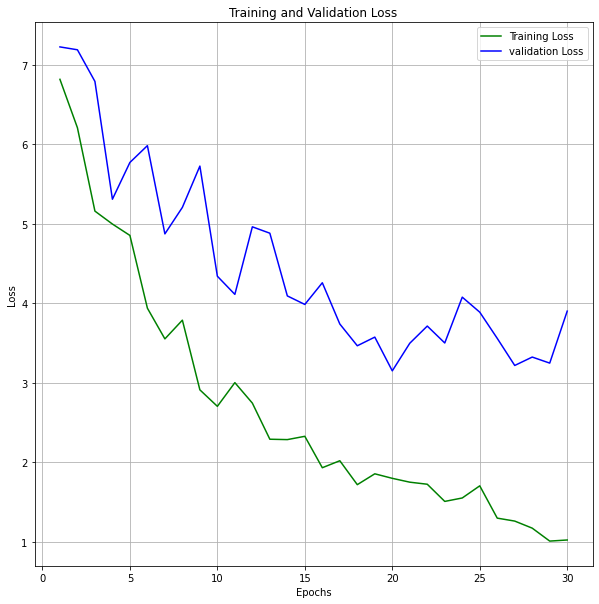

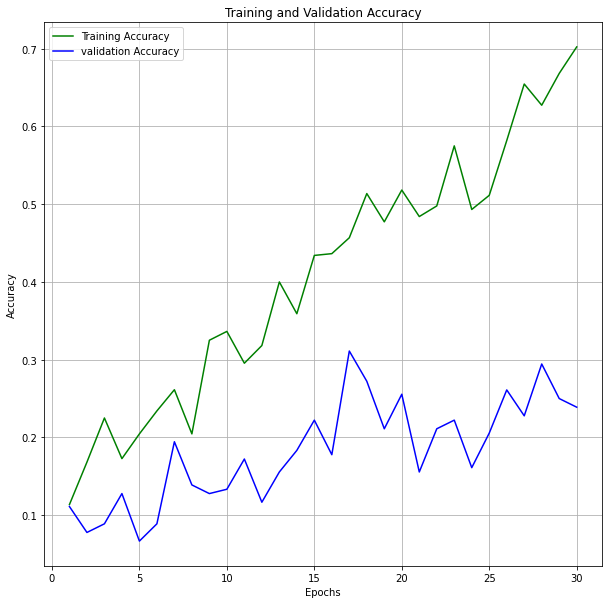

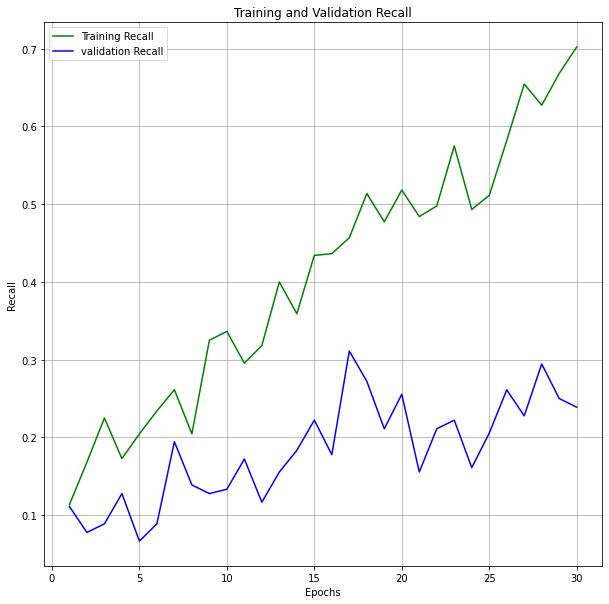

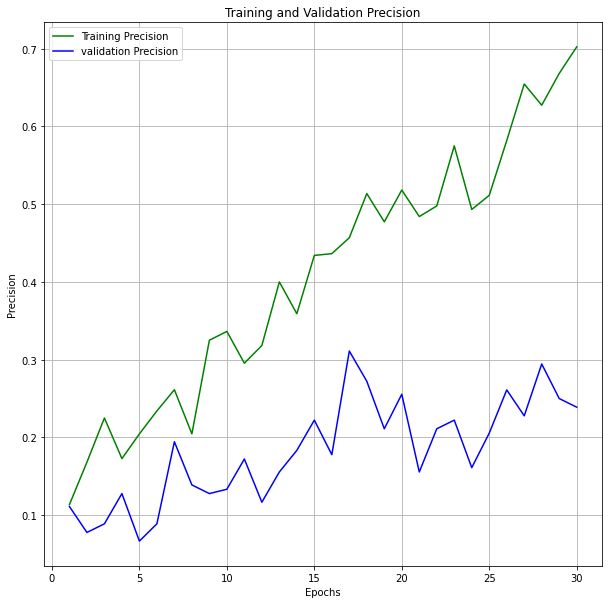

In [36]:
train(model_pretrain_vgg16, train_loader, test_loader)

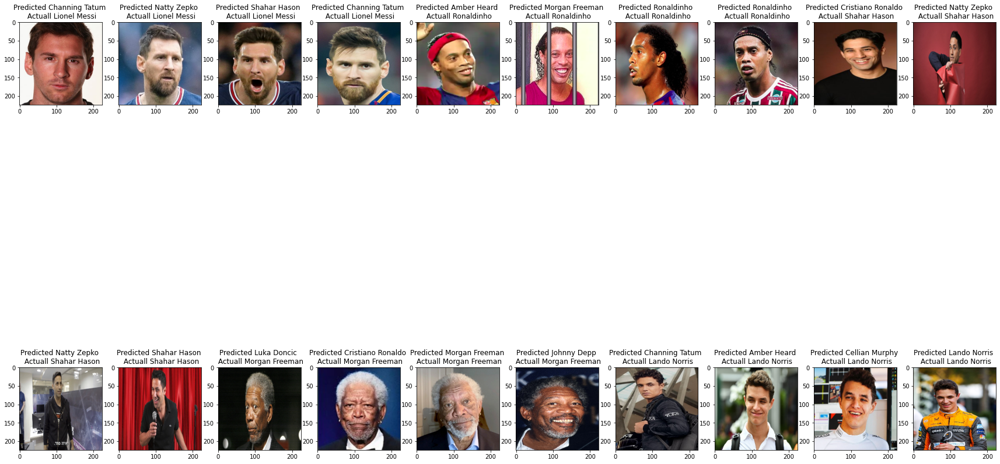

In [62]:
display_predicted_images(model_pretrain_vgg16)

##AlexNet

In [42]:
model_alexNet = models.AlexNet(len(labels_as_num))
optimizer = torch.optim.Adam(model_alexNet.parameters(), lr = 0.00001, weight_decay=0.1)
model_alexNet.to(device)
for param in model_alexNet.features.parameters():
    param.requires_grad = False

epoch #0 batch #0 loss = 2.623 accuracy = 0.10
epoch #0 batch #5 loss = 2.680 accuracy = 0.00
epoch #0 batch #10 loss = 2.753 accuracy = 0.00

Epoch #0: Train Loss = 2.695431254126809 Validation Loss = 2.69303560256958
Epoch #0: Accuracy = 0.054545458406209946 Validation Accuracy = 0.09444444626569748
Epoch #0: Recall = 0.054545458406209946 Validation Recall = 0.09444444626569748
Epoch #0: Precision = 0.054545458406209946 Validation Precision = 0.09444444626569748


epoch #1 batch #0 loss = 2.708 accuracy = 0.05
epoch #1 batch #5 loss = 2.493 accuracy = 0.10
epoch #1 batch #10 loss = 2.649 accuracy = 0.25

Epoch #1: Train Loss = 2.6294748999855737 Validation Loss = 2.608912467956543
Epoch #1: Accuracy = 0.072727270424366 Validation Accuracy = 0.10555555671453476
Epoch #1: Recall = 0.072727270424366 Validation Recall = 0.10555555671453476
Epoch #1: Precision = 0.072727270424366 Validation Precision = 0.10555555671453476


epoch #2 batch #0 loss = 2.596 accuracy = 0.10
epoch #2 batch #5 

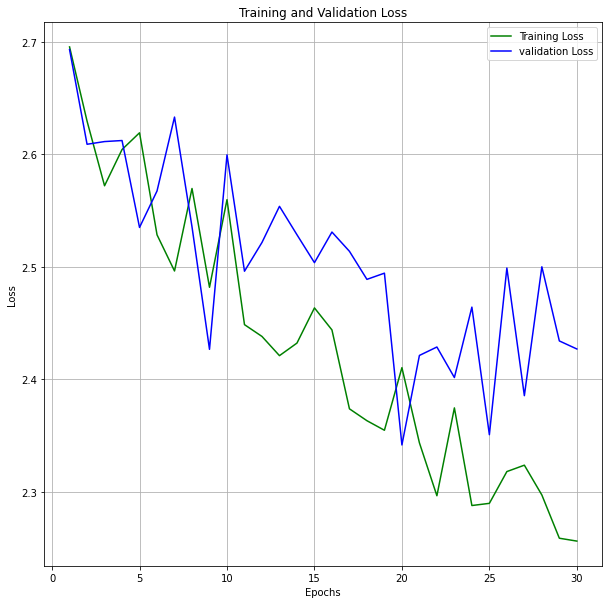

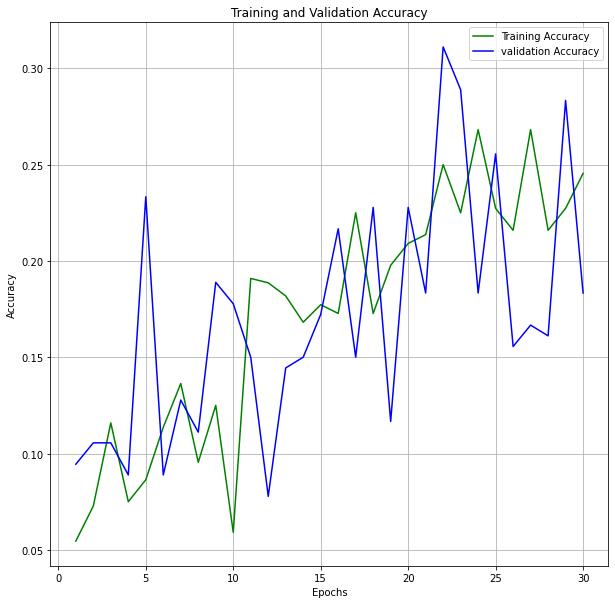

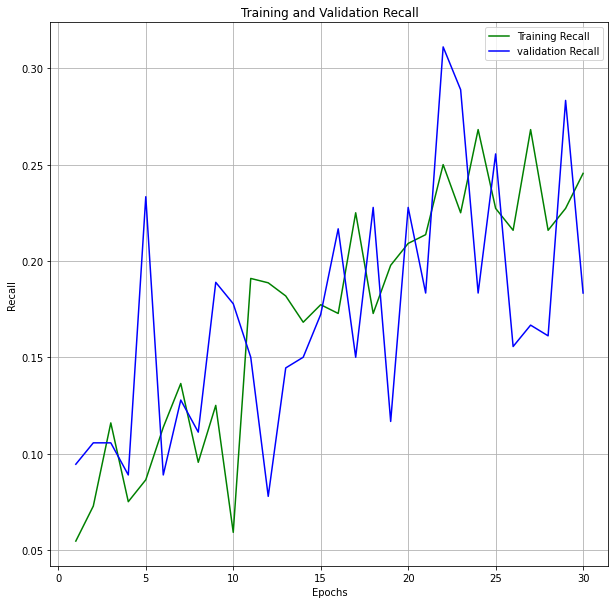

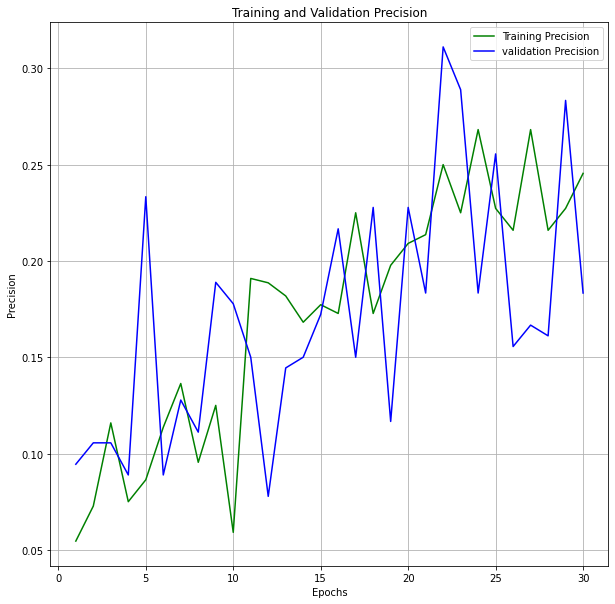

In [43]:
train(model_alexNet, train_loader, test_loader)

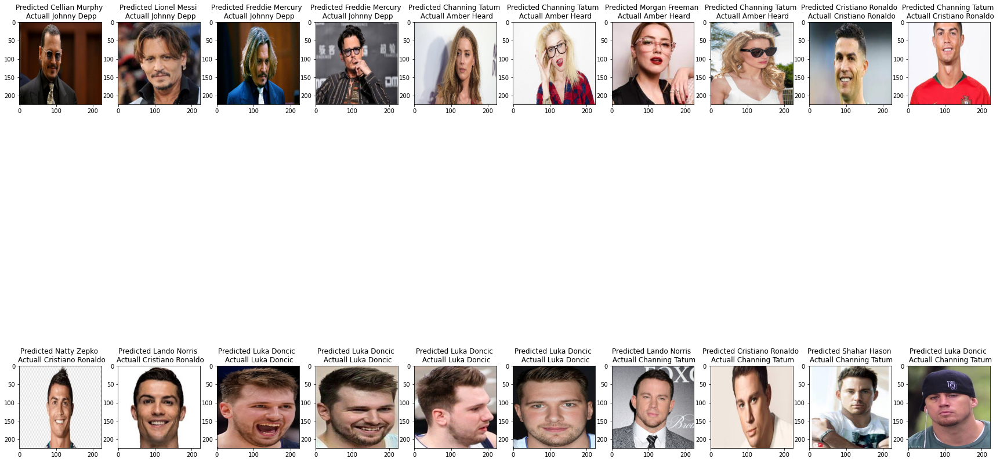

In [66]:
display_predicted_images(model_alexNet)

##Efficient Net

In [44]:
model_EffNet = models.efficientnet_b3(pretrained=True)
model_EffNet.classifier[1] = nn.Linear(in_features=1536,out_features=len(labels_as_num),bias = True)
optimizer = torch.optim.Adam(model_EffNet.parameters(), lr = 0.00001, weight_decay=0.1)
model_EffNet.to(device)
for param in model_EffNet.features.parameters():
    param.requires_grad = False

Downloading: "https://download.pytorch.org/models/efficientnet_b3_rwightman-cf984f9c.pth" to /root/.cache/torch/hub/checkpoints/efficientnet_b3_rwightman-cf984f9c.pth


  0%|          | 0.00/47.2M [00:00<?, ?B/s]

In [45]:
model_EffNet.classifier

Sequential(
  (0): Dropout(p=0.3, inplace=True)
  (1): Linear(in_features=1536, out_features=13, bias=True)
)

epoch #0 batch #0 loss = 2.543 accuracy = 0.15
epoch #0 batch #5 loss = 2.509 accuracy = 0.10
epoch #0 batch #10 loss = 2.671 accuracy = 0.00

Epoch #0: Train Loss = 2.5636627023870293 Validation Loss = 2.548107624053955
Epoch #0: Accuracy = 0.08636363595724106 Validation Accuracy = 0.07777778059244156
Epoch #0: Recall = 0.08636363595724106 Validation Recall = 0.07777778059244156
Epoch #0: Precision = 0.08636363595724106 Validation Precision = 0.07777778059244156


epoch #1 batch #0 loss = 2.636 accuracy = 0.05
epoch #1 batch #5 loss = 2.526 accuracy = 0.10
epoch #1 batch #10 loss = 2.563 accuracy = 0.12

Epoch #1: Train Loss = 2.573458433151245 Validation Loss = 2.5586537520090737
Epoch #1: Accuracy = 0.06590909510850906 Validation Accuracy = 0.0833333358168602
Epoch #1: Recall = 0.06590909510850906 Validation Recall = 0.0833333358168602
Epoch #1: Precision = 0.06590909510850906 Validation Precision = 0.0833333358168602


epoch #2 batch #0 loss = 2.562 accuracy = 0.20
epoch #2 batch #

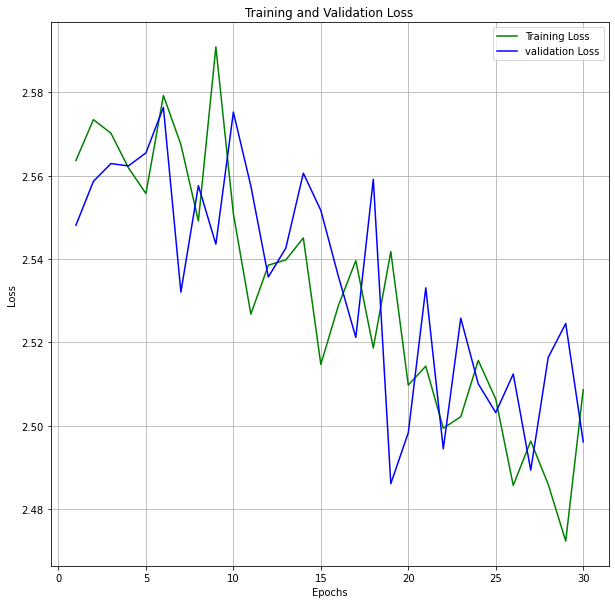

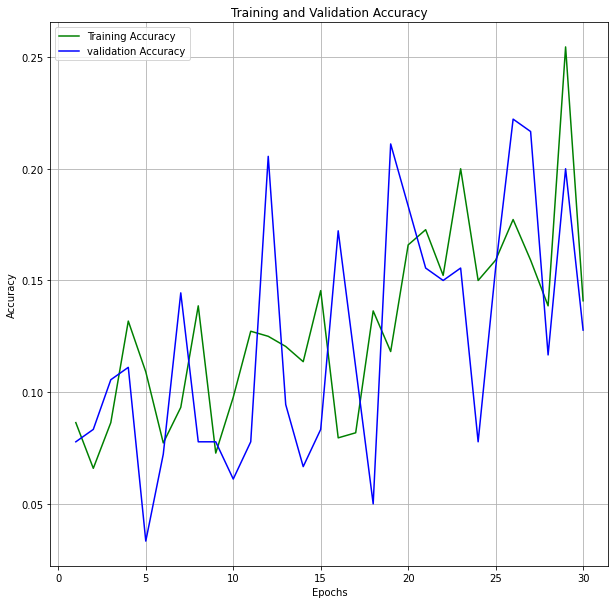

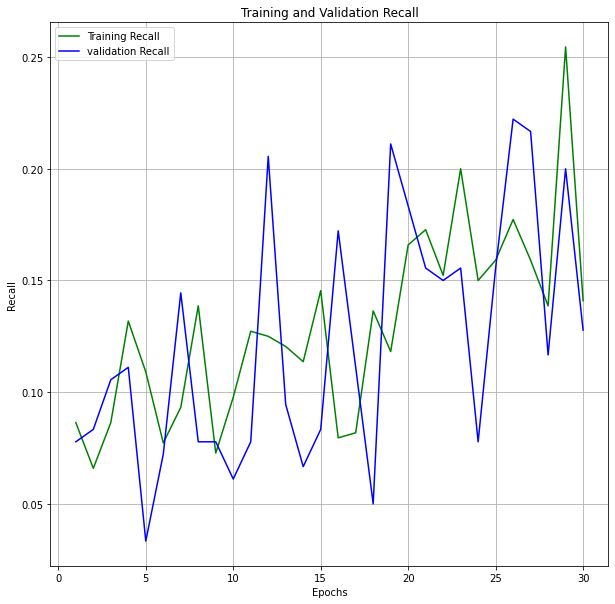

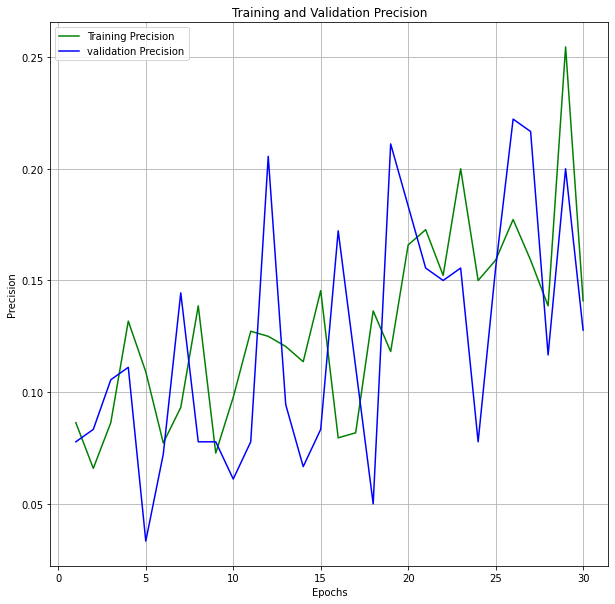

In [46]:
train(model_EffNet, train_loader, test_loader)

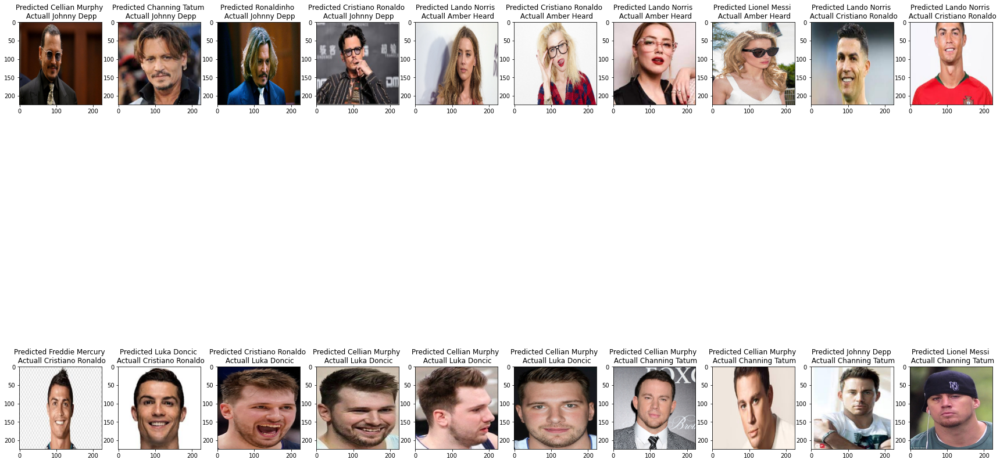

In [68]:
display_predicted_images(model_EffNet)

##ResNet

In [47]:
model_ResNet = models.resnet50(pretrained=True)
model_ResNet.fc = nn.Linear(in_features=2048, out_features=len(labels_as_num),bias = True)
optimizer = torch.optim.Adam(model_ResNet.parameters(), lr = 0.00001, weight_decay=0.1)
model_ResNet.to(device)
ct = 0
for child in model_ResNet.children():
  ct += 1
  if ct < 7:
    for param in child.parameters():
        param.requires_grad = False

Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth


  0%|          | 0.00/97.8M [00:00<?, ?B/s]

In [48]:
model_ResNet

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

epoch #0 batch #0 loss = 2.585 accuracy = 0.00
epoch #0 batch #5 loss = 2.543 accuracy = 0.05
epoch #0 batch #10 loss = 2.715 accuracy = 0.00

Epoch #0: Train Loss = 2.5868744416670366 Validation Loss = 2.5497172673543296
Epoch #0: Accuracy = 0.10909091681241989 Validation Accuracy = 0.21111111342906952
Epoch #0: Recall = 0.10909091681241989 Validation Recall = 0.21111111342906952
Epoch #0: Precision = 0.10909091681241989 Validation Precision = 0.21111111342906952


epoch #1 batch #0 loss = 2.456 accuracy = 0.05
epoch #1 batch #5 loss = 2.397 accuracy = 0.20
epoch #1 batch #10 loss = 2.439 accuracy = 0.38

Epoch #1: Train Loss = 2.4755235585299404 Validation Loss = 2.4977406660715737
Epoch #1: Accuracy = 0.17954546213150024 Validation Accuracy = 0.21666665375232697
Epoch #1: Recall = 0.17954546213150024 Validation Recall = 0.21666665375232697
Epoch #1: Precision = 0.17954546213150024 Validation Precision = 0.21666665375232697


epoch #2 batch #0 loss = 2.386 accuracy = 0.25
epoch #2 ba

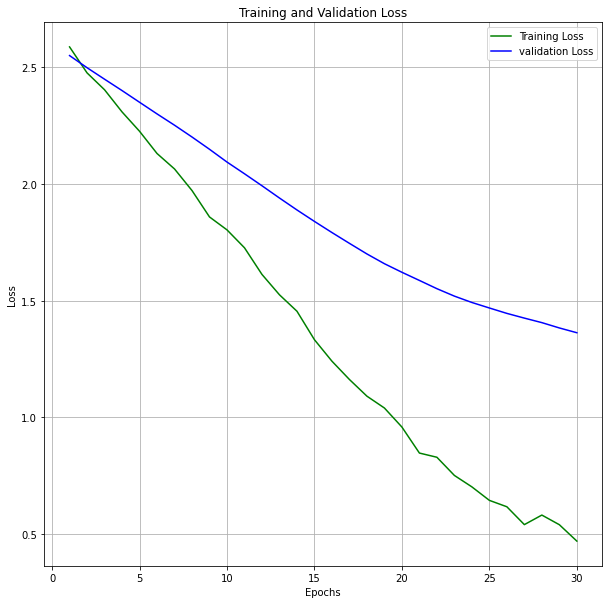

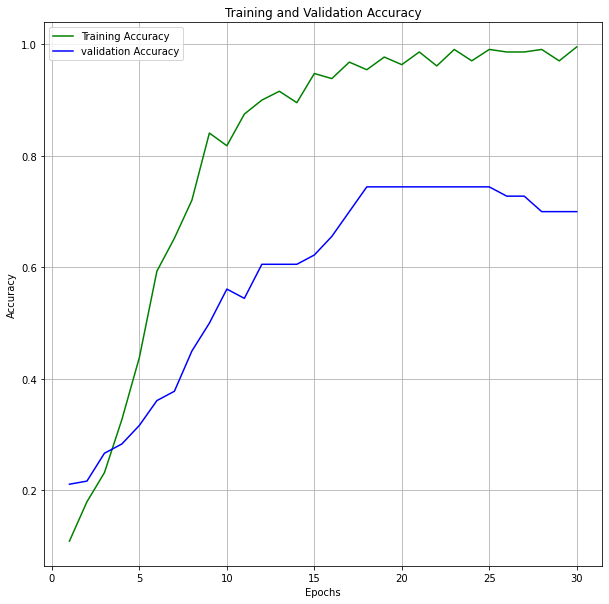

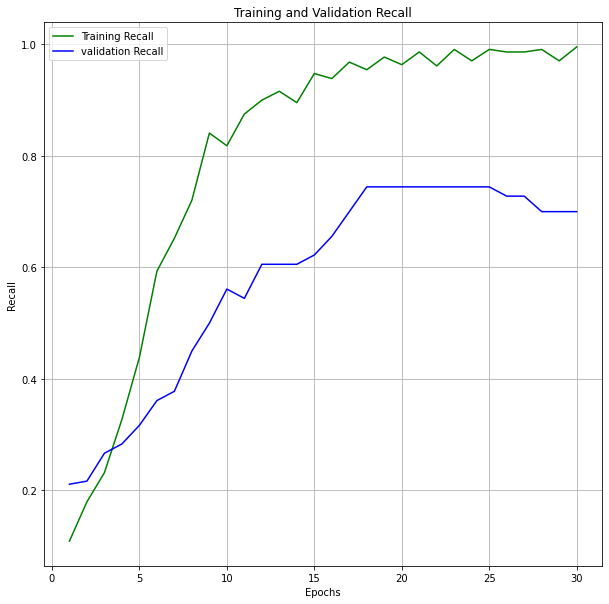

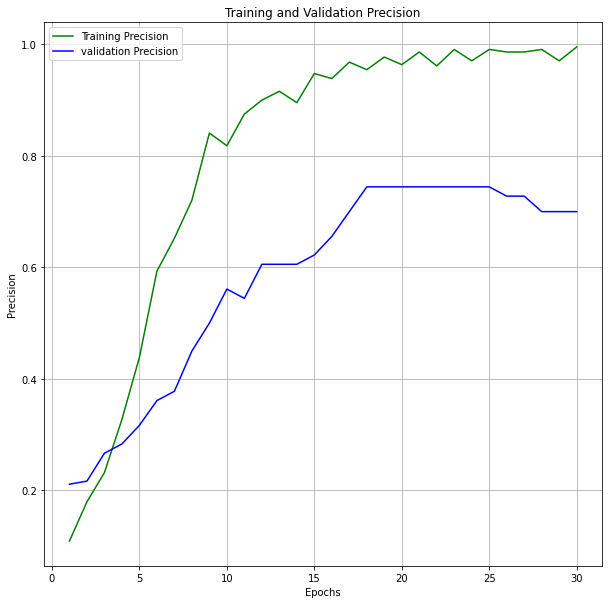

In [49]:
train(model_ResNet, train_loader, test_loader)

Who's a good classification arcitecture for this data? Yes you are! Yes you are! Good ResNet. Now Sit.

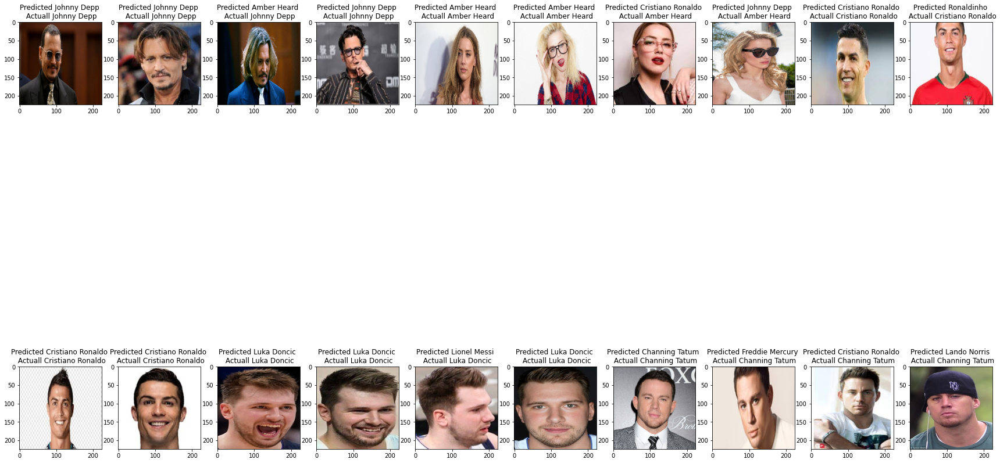

In [69]:
display_predicted_images(model_ResNet)

##Mobile Net

In [50]:
model_MobileNet = models.mobilenet_v3_large(pretrained=True)
model_MobileNet.classifier[3] = torch.nn.Linear(in_features=1280, out_features=len(labels_as_num), bias=True)
model_MobileNet.classifier[2] = nn.Dropout(p=0.65, inplace=True)
optimizer = torch.optim.Adam(model_MobileNet.parameters(), lr = 0.00001, weight_decay=0.1)
model_MobileNet.to(device)
for param in model_MobileNet.features.parameters():
    param.requires_grad = False

Downloading: "https://download.pytorch.org/models/mobilenet_v3_large-8738ca79.pth" to /root/.cache/torch/hub/checkpoints/mobilenet_v3_large-8738ca79.pth


  0%|          | 0.00/21.1M [00:00<?, ?B/s]

In [51]:
model_MobileNet

MobileNetV3(
  (features): Sequential(
    (0): ConvNormActivation(
      (0): Conv2d(3, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(16, eps=0.001, momentum=0.01, affine=True, track_running_stats=True)
      (2): Hardswish()
    )
    (1): InvertedResidual(
      (block): Sequential(
        (0): ConvNormActivation(
          (0): Conv2d(16, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=16, bias=False)
          (1): BatchNorm2d(16, eps=0.001, momentum=0.01, affine=True, track_running_stats=True)
          (2): ReLU(inplace=True)
        )
        (1): ConvNormActivation(
          (0): Conv2d(16, 16, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (1): BatchNorm2d(16, eps=0.001, momentum=0.01, affine=True, track_running_stats=True)
        )
      )
    )
    (2): InvertedResidual(
      (block): Sequential(
        (0): ConvNormActivation(
          (0): Conv2d(16, 64, kernel_size=(1, 1), stride=(1, 1), bias=False

epoch #0 batch #0 loss = 2.674 accuracy = 0.00
epoch #0 batch #5 loss = 2.724 accuracy = 0.05
epoch #0 batch #10 loss = 2.836 accuracy = 0.00

Epoch #0: Train Loss = 2.710132273760709 Validation Loss = 2.6195527712504068
Epoch #0: Accuracy = 0.04545454680919647 Validation Accuracy = 0.05000000074505806
Epoch #0: Recall = 0.04545454680919647 Validation Recall = 0.05000000074505806
Epoch #0: Precision = 0.04545454680919647 Validation Precision = 0.05000000074505806


epoch #1 batch #0 loss = 2.796 accuracy = 0.05
epoch #1 batch #5 loss = 2.579 accuracy = 0.00
epoch #1 batch #10 loss = 2.612 accuracy = 0.12

Epoch #1: Train Loss = 2.6703789234161377 Validation Loss = 2.569575389226278
Epoch #1: Accuracy = 0.0522727333009243 Validation Accuracy = 0.12777778506278992
Epoch #1: Recall = 0.0522727333009243 Validation Recall = 0.12777778506278992
Epoch #1: Precision = 0.0522727333009243 Validation Precision = 0.12777778506278992


epoch #2 batch #0 loss = 2.650 accuracy = 0.00
epoch #2 batch #

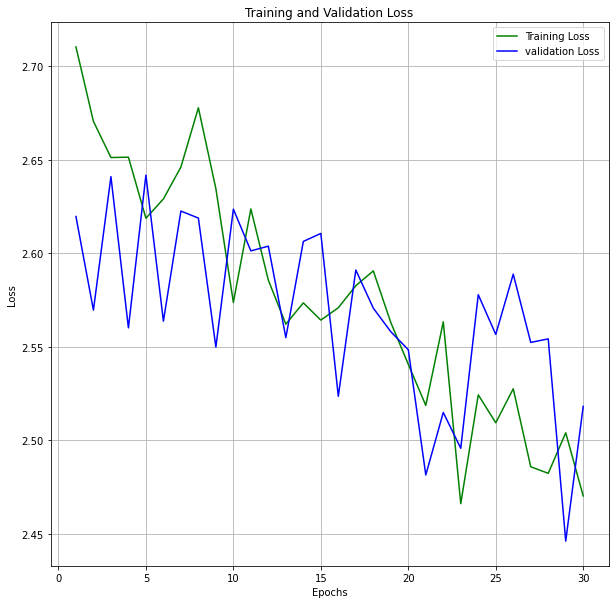

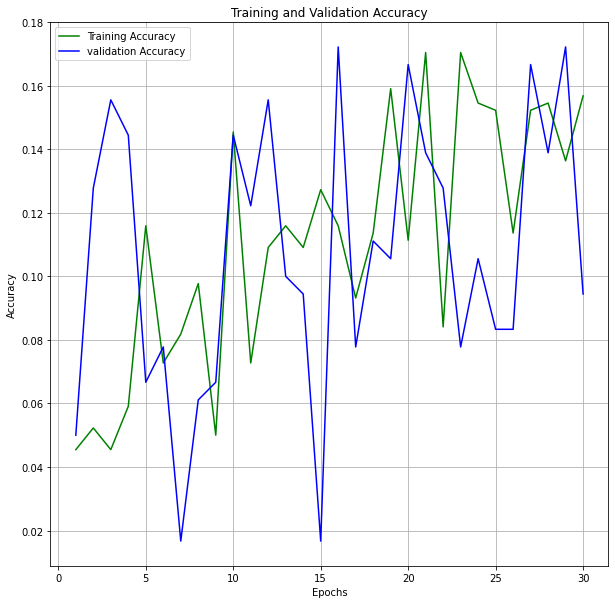

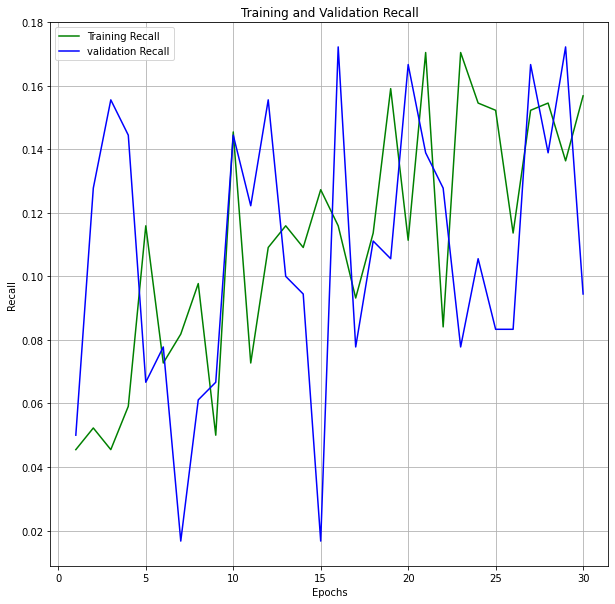

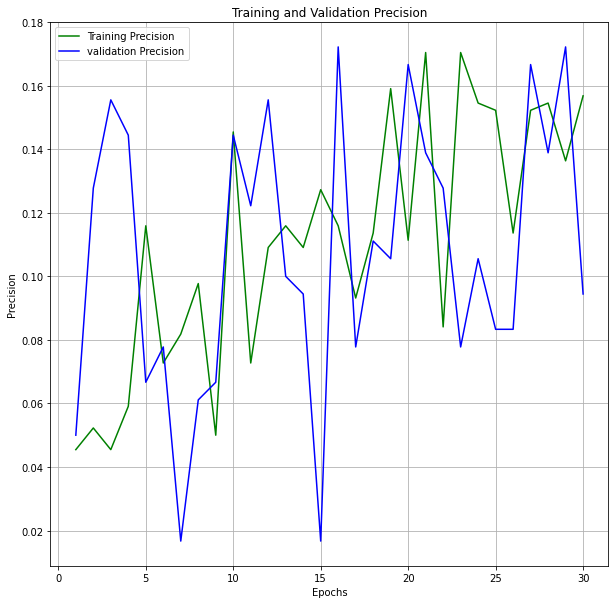

In [52]:
train(model_MobileNet, train_loader, test_loader)

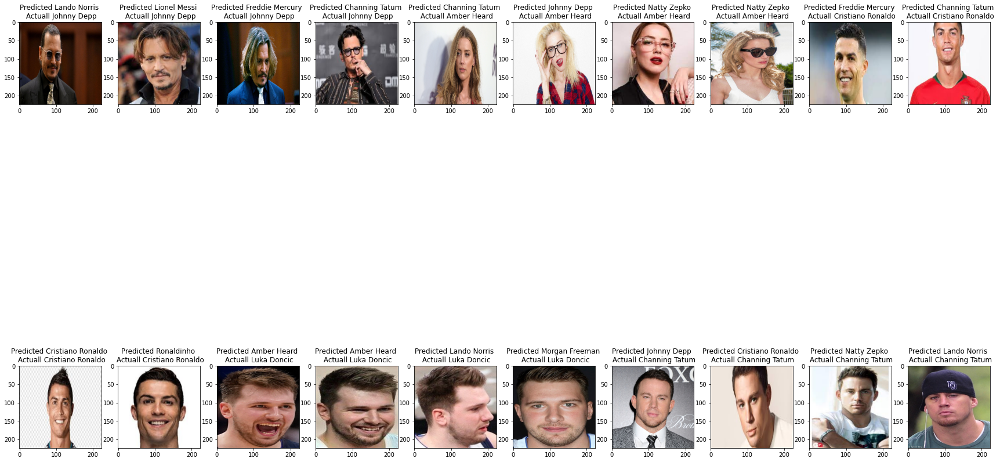

In [70]:
display_predicted_images(model_MobileNet)

#Ensemble

Done in form of average of prediction score. Since ResNet is such a good boi, we gave to it extra weight over the others.

In [53]:
def test(model_effNet, model_resNet, model_mobile_net, model_alexNet, model_vgg16, test_loader):
  accuracy = 0
  with torch.no_grad():
    for i, data in enumerate(test_loader, 1):
        img, labels = data
        img = img.float().to(device)
        labels = getnumericalLabels(labels)

        output_effNet = model_effNet(img).detach().cpu().numpy()
        output_resNet = model_resNet(img).detach().cpu().numpy()
        output_mobileNet = model_mobile_net(img).detach().cpu().numpy()
        output_vgg = model_vgg16(img).detach().cpu().numpy()
        output_alexNet = model_alexNet(img).detach().cpu().numpy()

        output = []
        for eff, res, mob, vgg, alex in zip(output_effNet, output_resNet, output_mobileNet, output_vgg,output_alexNet):
            output.append([(eff_Type + 3*res_Type + mob_Type + vgg_Type + alex_Type) / 7
                              for eff_Type, res_Type, mob_Type, vgg_Type, alex_Type in zip(eff, res, mob, vgg, alex)]) #Ensemble - Mean output by some different networks

        for i, pred in enumerate(np.argmax(softmax(output, axis=1), axis=1)):
          if pred == labels[i]:
            accuracy += 1  

  print("Accuracy = ", accuracy/test_loader.dataset.size)

In [54]:
test_predict = test(model_EffNet, model_ResNet, model_MobileNet, model_alexNet, model_pretrain_vgg16, test_loader)

Accuracy =  0.5961538461538461


#Conclution/Summury/TLDR

In this report we have build facial recognition models. To start we build and trained from scratch VGG16 - CNN architecture which gave low results. Then we used pre trained VGG16 to see the difference between pre trained architecture and not. The pre trained VGG16 gave better results, although still not sufficient.
Next we repeated the process for other pre trained architectures which are: AlexNet, EfficientNET, MobileNET and RESnet.

 The size of the data set with which we work is really small, which is one more reason why the surprise of the day was RESnet with around 0.7 accuracy on validation.

At the end we have made Ensemble from the 5 trained models (not including the self made VGG16). Because of the outstanding results of RESnet we gave to it bigger weight in calculation of Ensemble result.

The accuracy we got from ensemble was aprox 0.6 which is significantly high the all the models individually (except ResNet - the hero of this task).

In [72]:
%%shell
jupyter nbconvert --to html /content/Ex3_314920505_324620442.ipynb

[NbConvertApp] Converting notebook /content/Ex3_314920505_324620442.ipynb to html
[NbConvertApp] Writing 22052178 bytes to /content/Ex3_314920505_324620442.html
